In [1]:
import os
os.environ['HDF5_USE_FILE_LOCKING'] = 'FALSE'

In [2]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata
import re

In [3]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm

In [4]:
import sys
sys.path.append('../../ext/')
import codes.py_util as util
import codes.py_wknn as wknn
import codes.scarches_label_transfer as sclt
import codes.simspec as simspec

In [5]:
os.chdir("/links/groups/treutlein/USERS/zhisong_he/Work/brain_organoid_atlas/analysis/disease")

# Analysis on the disease data cohort itself

## Routine analysis

In [4]:
adata = sc.read_h5ad('merged.h5ad')

In [5]:
adata.raw = adata
adata = adata[:,adata.var['highly_variable']]
sc.pp.scale(adata)
sc.pp.pca(adata, n_comps=20)
sc.pp.neighbors(adata)
sc.tl.umap(adata)

In [6]:
adata.obs

,sample,age,sex,disease,condition,publication,sc_method,batch_in_data
AAACCTGAGATCACGG-1,C4,nan,nan,control,control,"Notaras, 2022",10x_v3,1
AAACGGGGTCTGATCA-1,C4,nan,nan,control,control,"Notaras, 2022",10x_v3,1
AAACGGGGTTGCCTCT-1,C4,nan,nan,control,control,"Notaras, 2022",10x_v3,1
AAAGCAAGTCCGAATT-1,C4,nan,nan,control,control,"Notaras, 2022",10x_v3,1
AAAGCAATCCAGAGGA-1,C4,nan,nan,control,control,"Notaras, 2022",10x_v3,1
...,...,...,...,...,...,...,...,...
TTTGTTGCACCCATAA-1,GSM4848890_PTHS-8,56,nan,control,GABAergic-enriched_parent,"Papes, 2022",10x_v3,1
TTTGTTGCAGTTGTTG-1,GSM4848890_PTHS-8,56,nan,control,GABAergic-enriched_parent,"Papes, 2022",10x_v3,1
TTTGTTGGTCCGATCG-1,GSM4848890_PTHS-8,56,nan,control,GABAergic-enriched_parent,"Papes, 2022",10x_v3,1
TTTGTTGGTCTCTCCA-1,GSM4848890_PTHS-8,56,nan,control,GABAergic-enriched_parent,"Papes, 2022",10x_v3,1


In [23]:
adata.obsm['X_umap_raw'] = adata.obsm['X_umap'].copy()

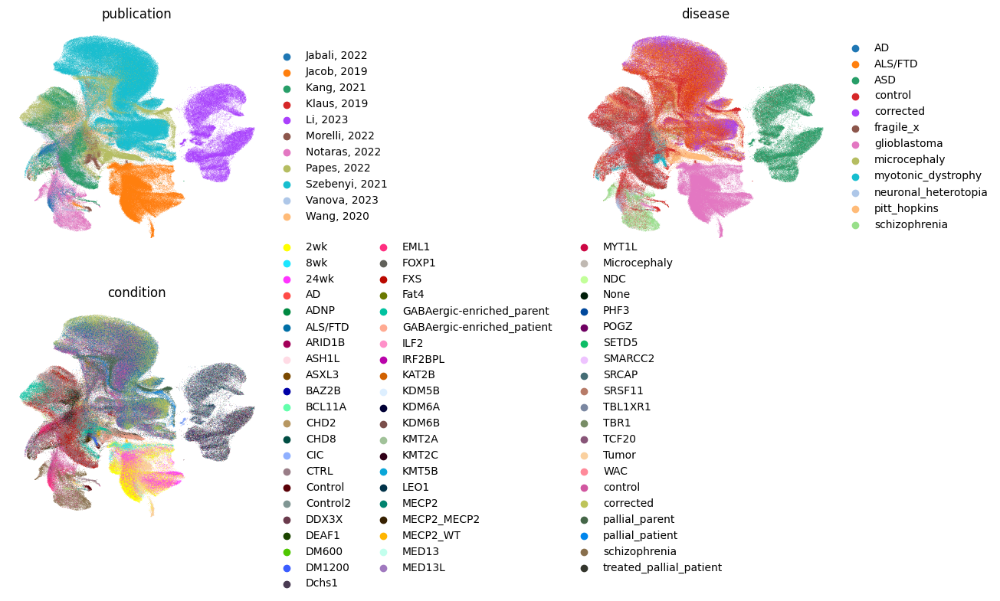

In [25]:
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (3.5,4)}):
    sc.pl.embedding(adata, basis='X_umap_raw',
                    color=['publication','disease','condition'],
                    frameon=False, add_outline=False, wspace=1, na_color='lightgray', size=0.5, ncols=2)

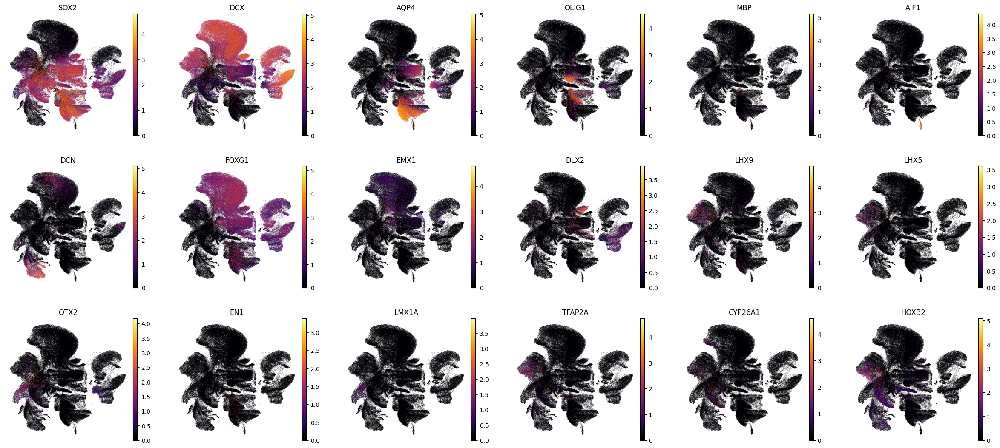

In [26]:
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (4,4)}):
    sc.pl.embedding(adata, basis='X_umap_raw',
                    color=['SOX2','DCX','AQP4','OLIG1','MBP','AIF1','DCN','FOXG1','EMX1','DLX2','LHX9','LHX5','OTX2','EN1','LMX1A','TFAP2A','CYP26A1','HOXB2'],
                    frameon=False, add_outline=False, color_map='inferno', size=0.5, ncols=6)

In [14]:
adata.write_h5ad('merged_processed.h5ad')

# Map to HNOCA scPoli space

In [4]:
import scarches

 captum (see https://github.com/pytorch/captum).


In [10]:
import torch
torch.cuda.is_available()

True

In [12]:
adata_hnoca = sc.read_h5ad('../../data/phase3_final_0516/ZH_processed_highvar.h5ad')
adata_hnoca.var_names_make_unique()

In [22]:
adata2map = sc.read_h5ad('merged.h5ad')
adata2map.X = adata2map.layers['counts'].copy()

import os
if os.path.isfile('merged_processed.h5ad'):
    adata = sc.read_h5ad('merged_processed.h5ad')
else:
    adata = adata2map.copy()

[ adata2map.shape, adata.shape ]

[(409277, 14323), (409277, 1469)]

In [23]:
adata2map.obs['batch'] = adata2map.obs['sample'].copy()
adata2map.obs['snapseed_pca_rss_level_1'] = 'unknown'
adata2map.obs['snapseed_pca_rss_level_12'] = 'unknown'
adata2map.obs['snapseed_pca_rss_level_123'] = 'unknown'

In [24]:
adata2map.var_names_make_unique()
adata2map = adata2map[:,np.isin(adata2map.var_names, adata_hnoca.var_names)]
adata2map.shape

(409277, 1451)

In [33]:
import anndata
from scipy.sparse import csr_matrix
from scipy.sparse import hstack

missing_features = np.setdiff1d(adata_hnoca.var_names, adata2map.var_names)
extra_X = csr_matrix((adata2map.shape[0], len(missing_features)), dtype=adata2map.X.dtype)
new_X = hstack((adata2map.X, extra_X))
new_var = pd.DataFrame({'symbol' : list(adata2map.var_names)+list(missing_features)}).set_axis(list(adata2map.var_names)+list(missing_features))
adata2map = anndata.AnnData(X = new_X, obs = adata2map.obs.copy(), var = new_var, obsm = adata2map.obsm.copy())
adata2map = adata2map[:,adata_hnoca.var_names]
adata2map.shape

(409277, 3000)

In [35]:
model = scarches.models.scPoli
model_path = '../phase_3_final_0516/models_HNOCA/scpoli_hierarchical123'

In [36]:
vae = model.load(model_path, adata_hnoca)
vae_q = model.load_query_data(
    adata=adata2map,
    reference_model=vae,
    unknown_ct_names=['unknown'],
    labeled_indices=[],
)

AnnData object with n_obs × n_vars = 1770578 × 3000
    obs: 'assay_sc', 'assay_differentiation', 'assay_type_differentiation', 'bio_sample', 'cell_line', 'cell_type', 'development_stage', 'disease', 'ethnicity', 'gm', 'id', 'individual', 'organ', 'organism', 'sex', 'state_exact', 'sample_source', 'source_doi', 'suspension_type_original', 'tech_sample', 'treatment', 'assay_sc_original', 'cell_line_original', 'cell_type_original', 'development_stage_original', 'disease_original', 'ethnicity_original', 'organ_original', 'organism_original', 'sex_original', 'suspension_type', 'obs_names_original', 'organoid_age_days', 'publication', 'doi', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'leiden_pca_unintegrated_1', 'leiden_pca_unintegrated_80', 'leiden_pca_rss_1', 'leiden_pca_rss_80', 'snapseed_pca_unintegrated_level_1', 'snapseed_pca_unintegrated_level_2', 'snapseed_pca_unintegrate

In [38]:
vae_q.train(
    n_epochs=30,
    pretraining_epochs=20,
    eta=10,
    batch_size = 16384
)

Initializing dataloaders
Starting training
 |█████████████-------| 66.7%  - val_loss: 1180.47 - val_cvae_loss: 1180.47
Initializing unlabeled prototypes with Leiden with an unknown number of  clusters.
Clustering succesful. Found 49 clusters.
 |████████████████████| 100.0%  - val_loss: 1180.79 - val_cvae_loss: 1180.79 - val_prototype_loss:    0.00 - val_unlabeled_loss:    0.36


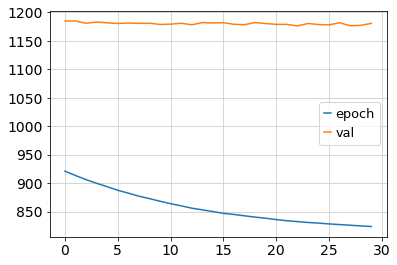

In [39]:
import matplotlib.pyplot as plt
plt.plot(vae_q.trainer.logs['epoch_loss'], label='epoch')
plt.plot(vae_q.trainer.logs['val_loss'], label='val')
plt.legend()

In [40]:
vae_q.save("models_scarches/HNOCA")

In [41]:
adata.obsm['X_scpoli_HNOCA'] = vae_q.get_latent(adata2map, mean=True)
sc.pp.neighbors(adata, use_rep='X_scpoli_HNOCA')
sc.tl.umap(adata)
adata.obsm['X_umap_scpoli_HNOCA'] = adata.obsm['X_umap'].copy()

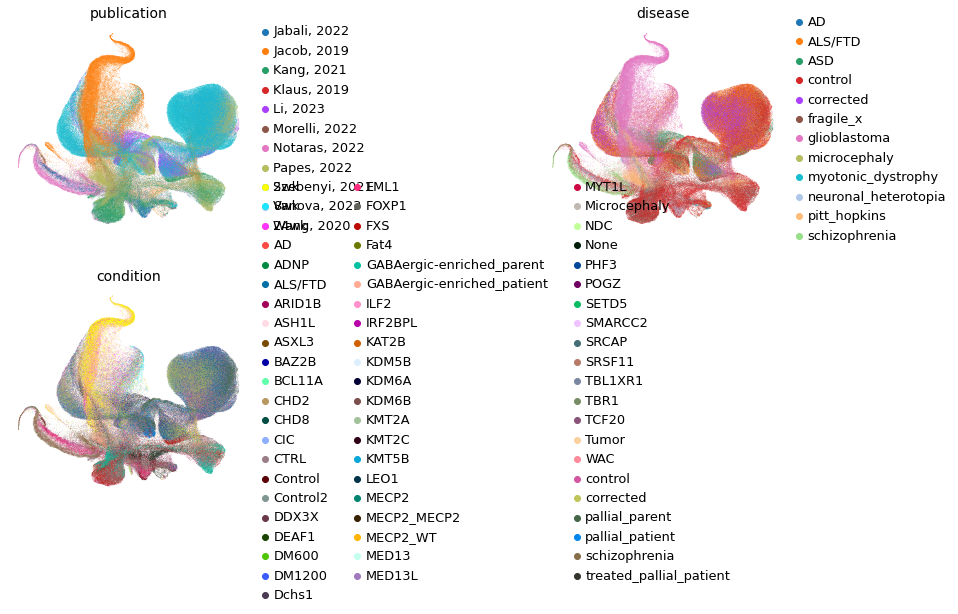

In [42]:
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (3.5,4)}):
    sc.pl.embedding(adata, basis='X_umap_scpoli_HNOCA',
                    color=['publication','disease','condition'],
                    frameon=False, add_outline=False, wspace=1, na_color='lightgray', size=0.5, ncols=2)

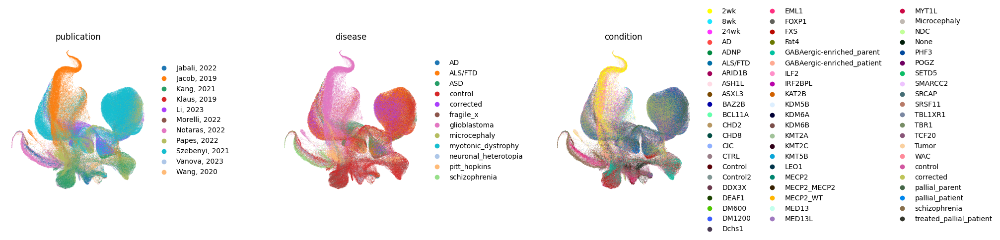

In [9]:
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (3.5,4)}):
    sc.pl.embedding(adata, basis='X_umap_scpoli_HNOCA',
                    color=['publication','disease','condition'],
                    frameon=False, add_outline=False, wspace=0.7, na_color='lightgray', size=0.5, ncols=3)

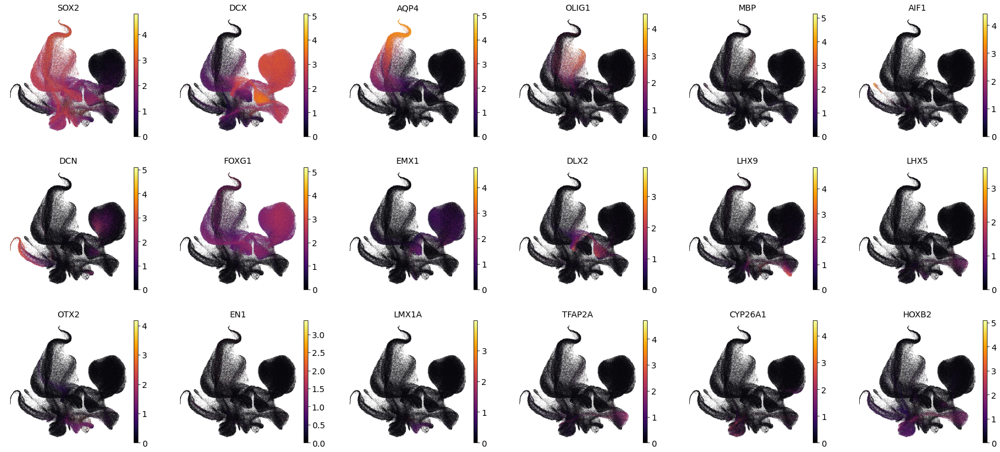

In [43]:
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (4,4)}):
    sc.pl.embedding(adata, basis='X_umap_scpoli_HNOCA',
                    color=['SOX2','DCX','AQP4','OLIG1','MBP','AIF1','DCN','FOXG1','EMX1','DLX2','LHX9','LHX5','OTX2','EN1','LMX1A','TFAP2A','CYP26A1','HOXB2'],
                    frameon=False, add_outline=False, color_map='inferno', size=0.5, ncols=6)

In [44]:
adata.write_h5ad('merged_processed.h5ad')

# Map to the Braun atlas scANVI space

In [45]:
import scvi

In [46]:
import torch
torch.cuda.is_available()

True

In [47]:
adata2map = sc.read_h5ad('merged.h5ad')
adata2map.X = adata2map.layers['counts'].copy()

import os
if os.path.isfile('merged_processed.h5ad'):
    adata = sc.read_h5ad('merged_processed.h5ad')
else:
    adata = adata2map.copy()

In [60]:
adata2map.var_names_make_unique()
adata2map.obs_names_make_unique()
adata2map.obs['batch'] = adata2map.obs['sample'].copy()

In [48]:
adata_ref = sc.read_h5ad('../../ext/models_Braun/scanvi/ref.h5ad')

In [58]:
adata_ref.var_names_make_unique()
adata_ref.obs_names_make_unique()

In [51]:
model = scvi.model.SCANVI
model_path = '../../ext/models_Braun/scanvi'

In [69]:
vae = model.load(model_path, adata=adata_ref)
model.prepare_query_anndata(adata2map, model_path)
vae_q = model.load_query_data(adata2map, model_path)

INFO     File ../../ext/models_Braun/scanvi/model.pt already downloaded                                            
INFO     File ../../ext/models_Braun/scanvi/model.pt already downloaded                                            
INFO     Found 100.0% reference vars in query data.                                                                
INFO     File ../../ext/models_Braun/scanvi/model.pt already downloaded                                            


In [70]:
vae_q.train(
    batch_size=8192,
    max_epochs=100,
    plan_kwargs=dict(weight_decay=0.0),
)

INFO     Training for 100 epochs.                                                                                  


INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: SLURM auto-requeueing enabled. Setting signal handlers.
INFO:lightning.pytorch.trainer.connectors.signal_connector:SLURM auto-requeueing enabled. Setting signal handlers.


Epoch 100/100: 100%|██████████| 100/100 [47:04<00:00, 28.29s/it, v_num=1, train_loss_step=666, train_loss_epoch=668]

INFO: `Trainer.fit` stopped: `max_epochs=100` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=100` reached.


Epoch 100/100: 100%|██████████| 100/100 [47:04<00:00, 28.24s/it, v_num=1, train_loss_step=666, train_loss_epoch=668]


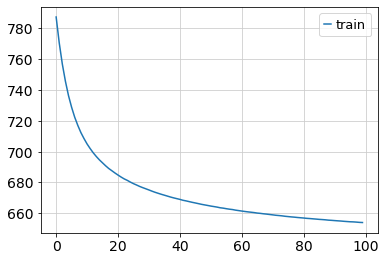

In [71]:
import matplotlib.pyplot as plt
plt.plot(vae_q.history['reconstruction_loss_train']['reconstruction_loss_train'], label='train')
plt.legend()

In [72]:
import os
os.makedirs('models_scarches/Braun', exist_ok=True)
vae_q.save(
    os.path.join('models_scarches/Braun', "model.pt"),
    overwrite=True,
    save_anndata=False,
)

In [73]:
adata.obsm['X_scanvi_Braun'] = vae_q.get_latent_representation(adata2map)
sc.pp.neighbors(adata, use_rep='X_scanvi_Braun')
sc.tl.umap(adata)
adata.obsm['X_umap_scanvi_Braun'] = adata.obsm['X_umap'].copy()

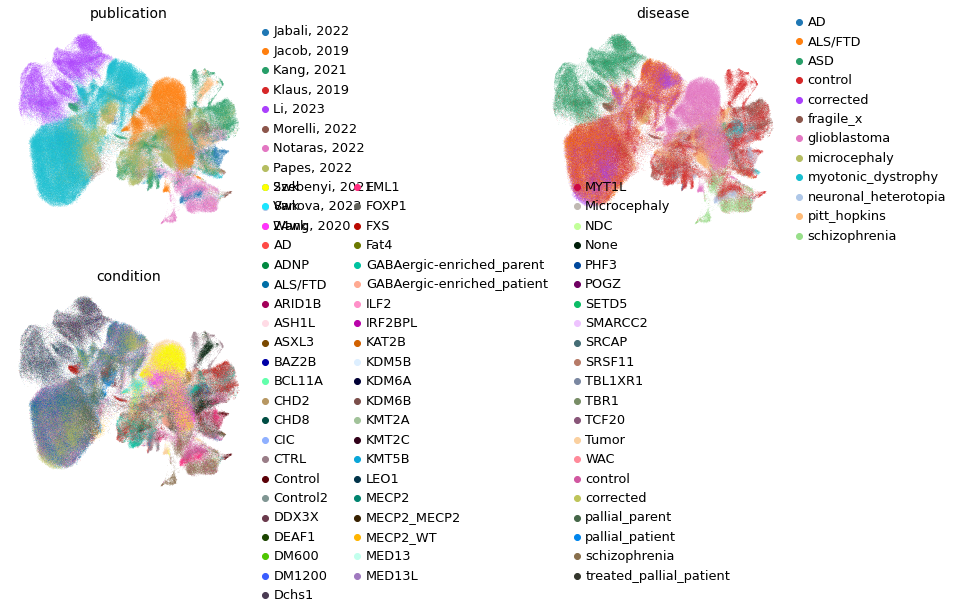

In [74]:
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (3.5,4)}):
    sc.pl.embedding(adata, basis='X_umap_scanvi_Braun',
                    color=['publication','disease','condition'],
                    frameon=False, add_outline=False, wspace=1, na_color='lightgray', size=0.5, ncols=2)

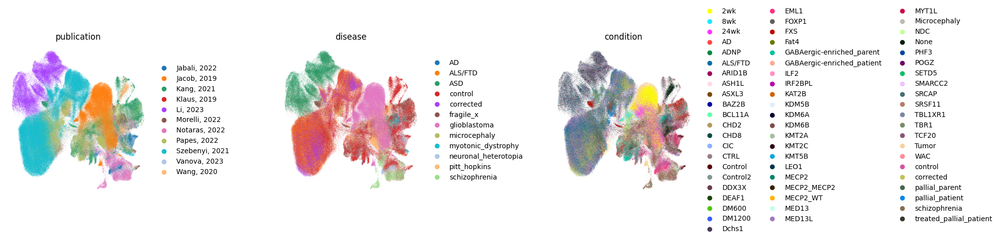

In [10]:
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (3.5,4)}):
    sc.pl.embedding(adata, basis='X_umap_scanvi_Braun',
                    color=['publication','disease','condition'],
                    frameon=False, add_outline=False, wspace=0.7, na_color='lightgray', size=0.5, ncols=3)

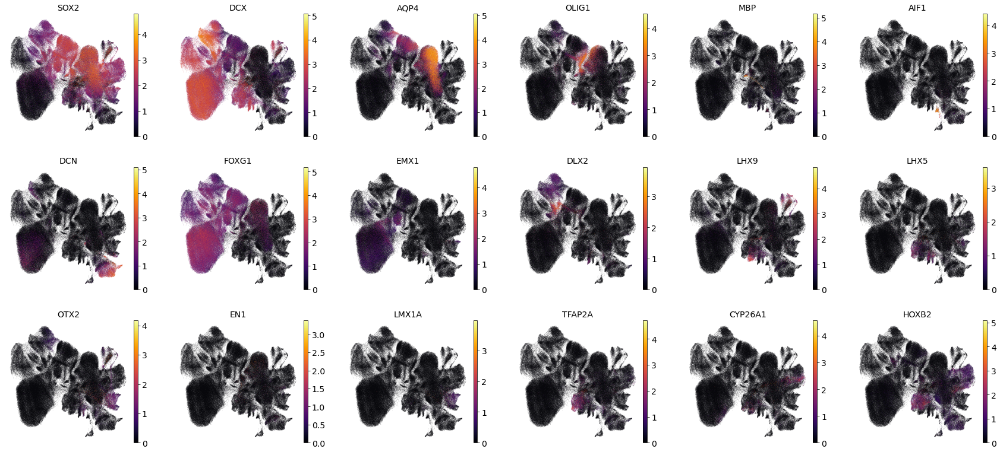

In [75]:
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (4,4)}):
    sc.pl.embedding(adata, basis='X_umap_scanvi_Braun',
                    color=['SOX2','DCX','AQP4','OLIG1','MBP','AIF1','DCN','FOXG1','EMX1','DLX2','LHX9','LHX5','OTX2','EN1','LMX1A','TFAP2A','CYP26A1','HOXB2'],
                    frameon=False, add_outline=False, color_map='inferno', size=0.5, ncols=6)

In [76]:
adata.write_h5ad('merged_processed.h5ad')

# wKNN-based Label transfer

## Label transfer from HNOCA considering both HNOCA-scPoli and Braun-scANVI representation

In [76]:
adata = sc.read_h5ad('merged_processed.h5ad')

In [77]:
adata_ref = sc.read_h5ad('../../data/phase3_final_0516/ZH_processed_cleanup.h5ad')

In [82]:
wknn_hnoca_q2r_plus = wknn.get_wknn(ref = np.concatenate([ adata_ref.obsm['X_scpoli'], adata_ref.obsm['X_scanvi_braun2'] ], axis=1),
                                    query = np.concatenate([ adata.obsm['X_scpoli_HNOCA'], adata.obsm['X_scanvi_Braun'] ], axis=1),
                                    k = 50,
                                    query2ref = True,
                                    ref2query = False,
                                    weighting_scheme = "jaccard_square")

Failed calling cuML. Falling back to neighborhood estimation using CPU with pynndescent
Failed calling cuML. Falling back to neighborhood estimation using CPU with pynndescent


In [83]:
df_labs_hnoca_plus = { 'annot_level_1' : wknn.transfer_labels(adata_ref, adata, wknn_hnoca_q2r_plus, label_key='annot_level_1'),
                       'annot_level_2' : wknn.transfer_labels(adata_ref, adata, wknn_hnoca_q2r_plus, label_key='annot_level_2'),
                       'annot_level_3' : wknn.transfer_labels(adata_ref, adata, wknn_hnoca_q2r_plus, label_key='annot_level_3'),
                       'annot_level_4' : wknn.transfer_labels(adata_ref, adata, wknn_hnoca_q2r_plus, label_key='annot_level_4'),
                       'annot_region' : wknn.transfer_labels(adata_ref, adata, wknn_hnoca_q2r_plus, label_key='annot_region'),
                       'annot_region_rev' : wknn.transfer_labels(adata_ref, adata, wknn_hnoca_q2r_plus, label_key='annot_region_rev'),
                       'annot_region_rev2' : wknn.transfer_labels(adata_ref, adata, wknn_hnoca_q2r_plus, label_key='annot_region_rev2')
                     }

In [95]:
import os
if not os.path.isdir('output'): os.mkdir('output')

import pickle
with open('output/wknn_hnoca_q2r_plus.pickle', 'wb') as f:
    pickle.dump(wknn_hnoca_q2r_plus, f)
with open('output/df_labs_hnoca_plus.pickle', 'wb') as f:
    pickle.dump(df_labs_hnoca_plus, f)

In [96]:
import pickle
with open('output/wknn_hnoca_q2r_plus.pickle', 'rb') as f:
    wknn_hnoca_q2r_plus = pickle.load(f)
with open('output/df_labs_hnoca_plus.pickle', 'rb') as f:
    df_labs_hnoca_plus = pickle.load(f)

In [85]:
adata.obs[[x+'_plus' for x in df_labs_hnoca_plus.keys()]] = pd.DataFrame(dict(zip([x+'_plus' for x in df_labs_hnoca_plus.keys()], [df_labs_hnoca_plus[x]['best_label'] for x in df_labs_hnoca_plus.keys()])))

In [86]:
adata.obs.head()

,sample,age,sex,disease,condition,publication,sc_method,batch_in_data,_scvi_batch,_scvi_labels,...,annot_region_rev,SummarizedRegion_hier,annot_region_rev2,annot_level_1_plus,annot_level_2_plus,annot_level_3_plus,annot_level_4_plus,annot_region_plus,annot_region_rev_plus,annot_region_rev2_plus
AAACCTGAGATCACGG-1,C4,nan,nan,control,control,"Notaras, 2022",10x_v3,1,38,0,...,Dorsal midbrain,Medulla,Dorsal midbrain,Neuron,Non-telencephalic Neuron,Medulla Neuron,Medulla Neuron NT-VGLUT,Medulla,Medulla,Medulla
AAACGGGGTCTGATCA-1,C4,nan,nan,control,control,"Notaras, 2022",10x_v3,1,38,0,...,Unspecific,Midbrain dorsal,Unspecific,MC,MC,MC,MC,Unspecific,Unspecific,Unspecific
AAACGGGGTTGCCTCT-1,C4,nan,nan,control,control,"Notaras, 2022",10x_v3,1,38,0,...,Cerebellum,Cerebellum,Cerebellum,NPC,Non-telencephalic NPC,Cerebellar NPC,Cerebellar NPC,Cerebellum,Cerebellum,Cerebellum
AAAGCAAGTCCGAATT-1,C4,nan,nan,control,control,"Notaras, 2022",10x_v3,1,38,0,...,Unspecific,Midbrain dorsal,Unspecific,MC,MC,MC,MC,Unspecific,Unspecific,Unspecific
AAAGCAATCCAGAGGA-1,C4,nan,nan,control,control,"Notaras, 2022",10x_v3,1,38,0,...,Unspecific,Pons,Unspecific,CP,CP,CP,CP,Unspecific,Unspecific,Unspecific


In [98]:
adata.obs['annot_region_rev2'].value_counts()

Dorsal telencephalon     165379
Unspecific               137191
Medulla                   35916
Ventral telencephalon     27517
Cerebellum                14463
Thalamus                  12521
Dorsal midbrain            6829
Pons                       5096
Hypothalamus               3504
Ventral midbrain            861
Name: annot_region_rev2, dtype: int64

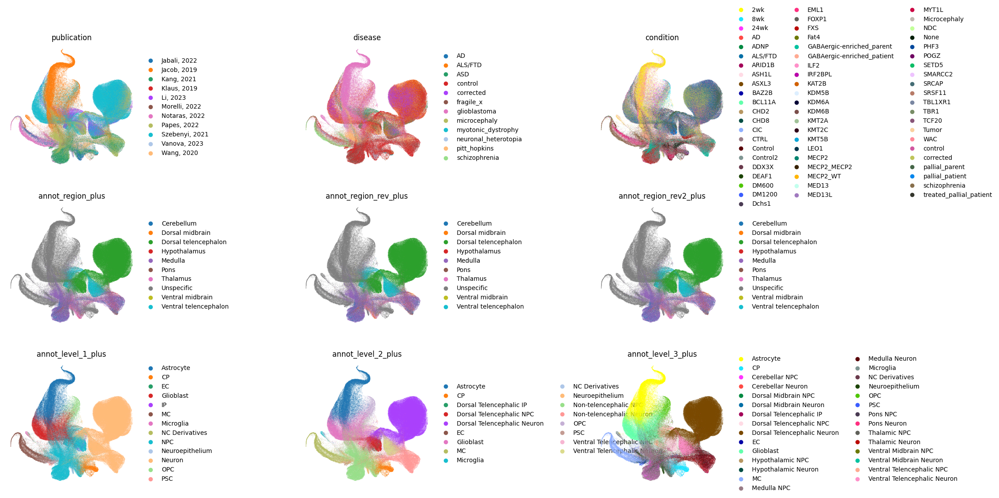

In [90]:
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (3.5,4)}):
    sc.pl.embedding(adata, basis='X_umap_scpoli_HNOCA',
                    color=['publication','disease','condition','annot_region_plus','annot_region_rev_plus','annot_region_rev2_plus','annot_level_1_plus','annot_level_2_plus','annot_level_3_plus'],
                    frameon=False, add_outline=False, wspace=1, na_color='lightgray', size=0.5, ncols=3)

In [107]:
adata.obs['annot_region_rev2'] = adata.obs['annot_region_rev2'].cat.reorder_categories(adata_ref.obs['annot_region_rev2'].cat.categories)
adata.obs['annot_region_rev2_plus'] = adata.obs['annot_region_rev2_plus'].cat.reorder_categories(adata_ref.obs['annot_region_rev2'].cat.categories)
adata.obs['SummarizedRegion_hier'] = adata.obs['SummarizedRegion_hier'].cat.reorder_categories(['Cortex','Subcortex','Hypothalamus','Thalamus','Midbrain dorsal','Midbrain ventral','Cerebellum','Medulla','Pons'])

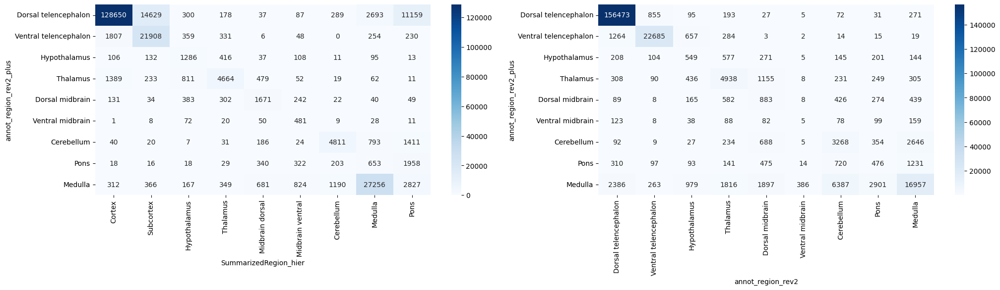

In [119]:
adata.obs_names_make_unique()
idx = ((adata.obs['annot_region_rev2'] != 'Unspecific') &
       np.isin(adata.obs['CellClass'], ['Radial glia','Neuron','Neuroblast','Neuronal IPC']) &
       (adata.obs['annot_region_rev2_plus'] != 'Unspecific'))
mat1 = pd.crosstab(adata.obs['annot_region_rev2_plus'].loc[idx], adata.obs['SummarizedRegion_hier'].loc[idx])
mat2 = pd.crosstab(adata.obs['annot_region_rev2_plus'].loc[idx], adata.obs['annot_region_rev2'].loc[idx])

import matplotlib.pyplot as plt
import seaborn as sns
fig, ax = plt.subplots(1,2,figsize=(24,5))
sns.heatmap(mat1, ax=ax[0], annot=True, cmap='Blues', fmt='d')
sns.heatmap(mat2, ax=ax[1], annot=True, cmap='Blues', fmt='d')
fig.show()

In [120]:
adata.write_h5ad('merged_processed.h5ad')

# Regional heterogeneity in conditions

In [115]:
meta_samples = adata.obs[['publication','disease','sample','condition','age']].value_counts(sort=False).reset_index().set_axis(['publication','disease','sample','condition','age','num_cells'],axis=1)
meta_samples['full_sample'] = meta_samples[['publication','disease','sample']].agg('_'.join, axis=1)
meta_samples

,publication,disease,sample,condition,age,num_cells,full_sample
0,"Jabali, 2022",control,GSM5844876_Control,Control,33,3180,"Jabali, 2022_control_GSM5844876_Control"
1,"Jabali, 2022",neuronal_heterotopia,GSM5844877_EML1,EML1,33,4055,"Jabali, 2022_neuronal_heterotopia_GSM5844877_EML1"
2,"Jacob, 2019",glioblastoma,8036_2wk,2wk,nan,2463,"Jacob, 2019_glioblastoma_8036_2wk"
3,"Jacob, 2019",glioblastoma,8036_8wk,8wk,nan,4064,"Jacob, 2019_glioblastoma_8036_8wk"
4,"Jacob, 2019",glioblastoma,8036_Tumor,Tumor,nan,2928,"Jacob, 2019_glioblastoma_8036_Tumor"
...,...,...,...,...,...,...,...
855,"Wang, 2020",control,hOrg180105-A2,None,P13,4585,"Wang, 2020_control_hOrg180105-A2"
856,"Wang, 2020",control,hOrg180905-Org1,None,P12,3773,"Wang, 2020_control_hOrg180905-Org1"
857,"Wang, 2020",control,hOrg190111_Org2,None,P14,5139,"Wang, 2020_control_hOrg190111_Org2"
858,"Wang, 2020",microcephaly,hOrg180105-A1,Microcephaly,P12,2306,"Wang, 2020_microcephaly_hOrg180105-A1"


In [300]:
adata.obs['annot_level_1_plus'] = adata.obs['annot_level_1_plus'].cat.reorder_categories([
    'PSC','Neuroepithelium','NPC','IP','Neuron','Glioblast','Astrocyte','OPC','CP','NC Derivatives','MC','EC','Microglia'
])

In [295]:
adata.obs['full_sample'] = adata.obs[['publication','disease','sample']].agg('_'.join, axis=1)
adata.obs.head()

,sample,age,sex,disease,condition,publication,sc_method,batch_in_data,_scvi_batch,_scvi_labels,...,annot_level_3_plus,annot_level_4_plus,annot_region_plus,annot_region_rev_plus,annot_region_rev2_plus,pearsonr_HNOCA_matched,is_control,avgdist_HNOCA_matched,pearsonr_HNOCA_matched_mtl,full_sample
AAACCTGAGATCACGG-1,C4,nan,nan,control,control,"Notaras, 2022",10x_v3,1,38,0,...,Medulla Neuron,Medulla Neuron NT-VGLUT,Medulla,Medulla,Medulla,0.769136,True,1.774837,0.754486,"Notaras, 2022_control_C4"
AAACGGGGTCTGATCA-1,C4,nan,nan,control,control,"Notaras, 2022",10x_v3,1,38,0,...,MC,MC,Unspecific,Unspecific,Unspecific,0.694569,True,1.655836,0.654339,"Notaras, 2022_control_C4"
AAACGGGGTTGCCTCT-1,C4,nan,nan,control,control,"Notaras, 2022",10x_v3,1,38,0,...,Cerebellar NPC,Cerebellar NPC,Cerebellum,Cerebellum,Cerebellum,0.880804,True,1.751299,0.868434,"Notaras, 2022_control_C4"
AAAGCAAGTCCGAATT-1,C4,nan,nan,control,control,"Notaras, 2022",10x_v3,1,38,0,...,MC,MC,Unspecific,Unspecific,Unspecific,0.576806,True,1.581710,0.562215,"Notaras, 2022_control_C4"
AAAGCAATCCAGAGGA-1,C4,nan,nan,control,control,"Notaras, 2022",10x_v3,1,38,0,...,CP,CP,Unspecific,Unspecific,Unspecific,0.522672,True,1.035988,0.527901,"Notaras, 2022_control_C4"


In [116]:
samples = meta_samples.loc[:,['publication','disease','full_sample']].value_counts(sort=False).reset_index().iloc[:,:3]

In [120]:
from matplotlib.cm import get_cmap
from matplotlib.colors import rgb2hex
cmap = get_cmap('tab20', len(samples['publication'].unique()))
col_ref = dict(zip(samples['publication'].unique(), [rgb2hex(cmap(i)) for i in range(cmap.N)]))
col_ref

{'Jabali, 2022': '#1f77b4',
 'Jacob, 2019': '#ff7f0e',
 'Kang, 2021': '#2ca02c',
 'Klaus, 2019': '#d62728',
 'Li, 2023': '#9467bd',
 'Morelli, 2022': '#8c564b',
 'Notaras, 2022': '#e377c2',
 'Papes, 2022': '#7f7f7f',
 'Szebenyi, 2021': '#bcbd22',
 'Vanova, 2023': '#17becf',
 'Wang, 2020': '#9edae5'}

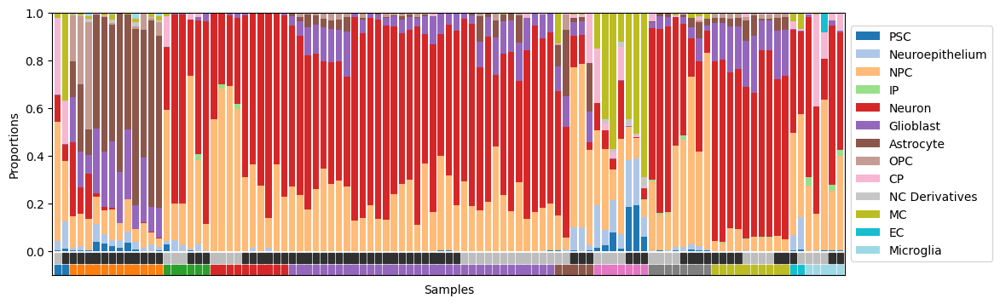

In [301]:
from matplotlib.patches import Rectangle
from matplotlib.cm import get_cmap
from matplotlib.colors import rgb2hex

idx = np.repeat(True, adata.shape[0])
freq_ct_samples = pd.crosstab(adata.obs['annot_level_1_plus'][idx], adata.obs['full_sample']).loc[:,samples['full_sample']]
prop_ct_samples = freq_ct_samples.apply(lambda x: x/np.sum(x), axis=0)

cmap = get_cmap('tab20', len(samples['publication'].unique()))
col_ref = dict(zip(samples['publication'].unique(), [rgb2hex(cmap(i)) for i in range(cmap.N)]))

with plt.rc_context({'figure.figsize' : (12,4)}):
    prop_ct_samples.transpose().plot(kind='bar', stacked=True, width=0.8, colormap='tab20')
    plt.xticks([])
    plt.xlabel('Samples')
    plt.ylabel('Proportions')
    plt.ylim(-0.1,1.0)
    for i in range(samples.shape[0]):
        plt.gca().add_patch(Rectangle((i-0.4,-0.1),0.8,0.04,fill=True, color=col_ref[samples['publication'][i]]))
        plt.gca().add_patch(Rectangle((i-0.4,-0.05),0.8,0.04,fill=True, color='#bdbdbd' if samples['disease'][i] == 'control' else '#303030'))
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

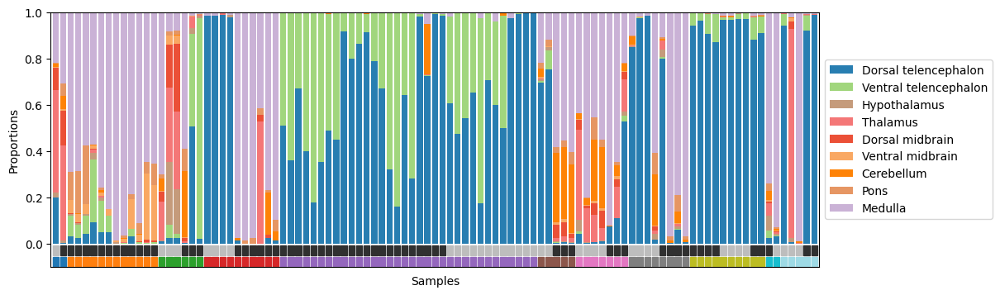

In [302]:
idx = ((np.isin(adata.obs['annot_level_1_plus'], ['NPC','IP','Neuron'])) & (adata.obs['annot_region_rev2_plus']!='Unspecific'))
freq_region_samples = pd.crosstab(adata.obs['annot_region_rev2_plus'][idx], adata.obs['full_sample']).loc[:,samples['full_sample']]
prop_region_samples = freq_region_samples.apply(lambda x: x/np.sum(x), axis=0)

with plt.rc_context({'figure.figsize' : (12,4)}):
    prop_region_samples.transpose().plot(kind='bar', stacked=True, width=0.8, color=['#287EB1','#A1D67D','#C59B7B','#F47777','#EB5037','#F9A863','#FE8307','#E69663','#CAB2D6'])
    plt.xticks([])
    plt.xlabel('Samples')
    plt.ylabel('Proportions')
    plt.ylim(-0.1,1.0)
    for i in range(samples.shape[0]):
        plt.gca().add_patch(Rectangle((i-0.4,-0.1),0.8,0.04,fill=True, color=col_ref[samples['publication'][i]]))
        plt.gca().add_patch(Rectangle((i-0.4,-0.05),0.8,0.04,fill=True, color='#bdbdbd' if samples['disease'][i] == 'control' else '#303030'))
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

In [303]:
adata.write_h5ad('merged_processed.h5ad')

# wKNN-based HNOCA background cell state estimation

## HNOCA-matched representative transcriptome

In [5]:
adata = sc.read_h5ad('merged_processed.h5ad')

In [142]:
adata_ref = sc.read_h5ad('../../data/phase3_final_0516/ZH_processed_cleanup.h5ad')

In [144]:
import pickle
with open('output/wknn_hnoca_q2r_plus.pickle', 'rb') as f:
    wknn_hnoca_q2r_plus = pickle.load(f)

In [145]:
from scipy import sparse
normmat = sparse.diags(1/np.array(wknn_hnoca_q2r_plus.sum(axis=1)).flatten())
softmax_wknn = normmat.dot(wknn_hnoca_q2r_plus)
softmax_wknn.shape

(409277, 1770578)

In [17]:
expr_HNOCA_10k = ((adata_ref.X.expm1())/100).log1p()
[ type(expr_HNOCA_10k), expr_HNOCA_10k.shape ]

[scipy.sparse._csr.csr_matrix, (1770578, 36842)]

In [18]:
expr_HNOCA_bg = softmax_wknn @ expr_HNOCA_10k
[ type(expr_HNOCA_bg), expr_HNOCA_bg.shape ]

[scipy.sparse._csr.csr_matrix, (409277, 36842)]

In [ ]:
def get_matched_transcriptome(adata,
                              adata_ref,
                              wknn, # output of wknn.get_wknn, based on the scPoli[HNOCA]-scANVI[Braun] concatenated representation
                              rescale_factor_ref = 1): # HNOCA uses targetsum=1m, disease data uses targetsum=10k, so rescale_factor_ref should be 10k/1m = 1/100
    expr_ref = adata_ref.X.copy()
    if rescale_factor_ref != 1:
        expr_ref = ((expr_ref.expm1()) * rescale_factor_ref).log1p()
    normmat = sparse.diags(1/np.array(wknn.sum(axis=1)).flatten())
    softmax_wknn = normmat.dot(wknn)
    expr_bg = softmax_wknn @ expr_ref
    adata_bg = anndata.AnnData(expr_bg, obs = adata.obs.copy(), var=adata_ref.var.copy(), obsm = adata.obsm.copy())
    return adata_bg

In [147]:
detrate_HNOCA_bg = softmax_wknn @ ((adata_ref.X > 0) * 1)
[ type(detrate_HNOCA_bg), detrate_HNOCA_bg.shape ]

[scipy.sparse._csr.csr_matrix, (409277, 36842)]

In [149]:
uwknn = (wknn_hnoca_q2r_plus > 0) * 1
normmat = sparse.diags(1/np.array(uwknn.sum(axis=1)).flatten())
softmax_uwknn = normmat.dot(uwknn)
softmax_uwknn.shape

(409277, 1770578)

In [150]:
detrate_HNOCA_bg_unweighted = softmax_uwknn @ ((adata_ref.X > 0) * 1)
[ type(detrate_HNOCA_bg_unweighted), detrate_HNOCA_bg_unweighted.shape ]

[scipy.sparse._csr.csr_matrix, (409277, 36842)]

In [26]:
adata_bg_expr = anndata.AnnData(expr_HNOCA_bg, obs = adata.obs.copy(), var=adata_ref.var.copy(), obsm = adata.obsm.copy())

In [27]:
adata_bg_expr.write_h5ad('merged_HNOCA_bg.h5ad')

In [143]:
shared_genes = np.intersect1d(adata.raw.var_names, adata_ref.var_names)
len(shared_genes)

14142

## Expression similarity to the matched HNOCA cell states

In [6]:
adata = sc.read_h5ad('merged_processed.h5ad')

In [7]:
adata_bg_expr = sc.read_h5ad('merged_HNOCA_bg.h5ad')

In [10]:
shared_highvar = np.intersect1d(adata_bg_expr.var_names[adata_bg_expr.var['highly_variable']], adata.raw.var_names)
len(shared_highvar)

1451

In [13]:
mat1 = adata.raw[:,shared_highvar].X.T
mat2 = adata_bg_expr[:,shared_highvar].X.T

In [15]:
column_pairs = [(mat1.getcol(i), mat2.getcol(i)) for i in range(mat1.shape[1])]

In [19]:
from scipy.stats import pearsonr
def calculate_correlation(col_pair):
    col1, col2 = col_pair
    return pearsonr(col1.toarray().flatten(), col2.toarray().flatten())[0]

In [20]:
from joblib import Parallel, delayed
correlations = Parallel(n_jobs=20)(delayed(calculate_correlation)(pair) for pair in column_pairs)

In [23]:
adata.obs['pearsonr_HNOCA_matched'] = correlations

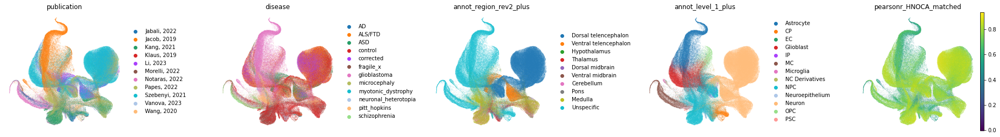

In [24]:
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (4,4)}):
    sc.pl.embedding(adata, basis='X_umap_scpoli_HNOCA',
                    color=['publication','disease','annot_region_rev2_plus','annot_level_1_plus','pearsonr_HNOCA_matched'],
                    frameon=False, add_outline=False, wspace=0.6, na_color='lightgray', size=0.5, ncols=5)

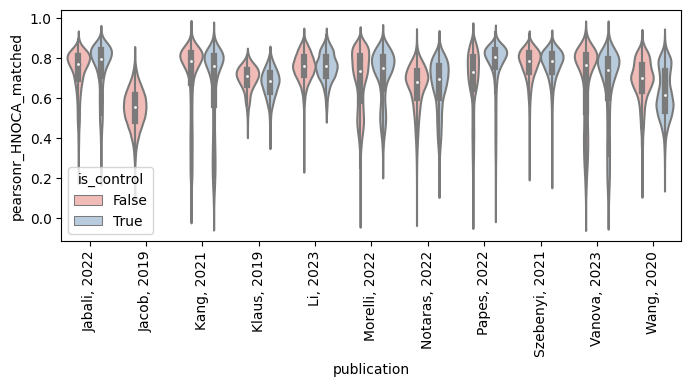

In [38]:
adata.obs['is_control'] = (np.isin(adata.obs['disease'], ['control','corrected']))
idx = np.repeat(True, adata.shape[0])
with plt.rc_context({'figure.figsize': (8, 3)}):
    ax = sns.violinplot(x="publication", y="pearsonr_HNOCA_matched", hue='is_control', data=adata.obs.loc[idx,:], palette="Pastel1")
    ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
    #plt.yscale('log')

In [79]:
adata.write_h5ad('merged_processed.h5ad')

# Differential expression analysis

In [6]:
adata = sc.read_h5ad('merged_processed.h5ad')

In [7]:
adata_bg_expr = sc.read_h5ad('merged_HNOCA_bg.h5ad')

## Jacob et al. 2019 (Glioblastoma organoid)

In [125]:
adata_jacob = adata[adata.obs['publication']=='Jacob, 2019',:]
adata_jacob = anndata.AnnData(X = adata.raw.X[adata.obs['publication']=='Jacob, 2019',:].copy(),
                              obs = adata_jacob.obs.copy(),
                              var = adata.raw.var.copy())
adata_jacob_bg = adata_bg_expr[adata_bg_expr.obs['publication']=='Jacob, 2019',:]
[adata_jacob.shape, adata_jacob_bg.shape]

[(59829, 14323), (59829, 36842)]

In [126]:
adata_jacob_bg.write_h5ad('Jacob2019_matched_HNOCA.h5ad')

### Test for the paired DE

In [43]:
from scipy.sparse import issparse
from scipy.stats import f
from statsmodels.formula.api import ols
from statsmodels.stats.anova import anova_lm
from joblib import Parallel, delayed
import multiprocessing
from tqdm import tqdm

def f_nonzero(e, covar=None):
    if issparse(e):
        e = e.todense()
    e = np.array(e).flatten()
    
    if covar is None:
        m1 = ols('e ~ 1', data=pd.DataFrame({'e': e})).fit()
        a1 = anova_lm(m1)
        fval = (np.sum(e**2)/len(e)) / a1.loc['Residual','mean_sq']
        p = 1-np.abs(0.5 - f.cdf(fval, len(e), a1.loc['Residual','df']))*2
        coef = m1.params['Intercept']
    else:
        data = pd.DataFrame({'e': e, **covar})
        m0 = ols('e ~ '+" + ".join(covar.columns)+' -1', data=data).fit()
        a0 = anova_lm(m0)
        m1 = ols('e ~ '+" + ".join(covar.columns), data=data).fit()
        a1 = anova_lm(m1)
        sumsq0 = a0.loc['Residual','sum_sq'] + (a0.iloc[:-1]['sum_sq'].sum() - a1.iloc[:-1]['sum_sq'].sum())
        meansq0 = sumsq0 / (a0.loc['Residual','df']+1)
        meansq1 = a1.loc['Residual','mean_sq']
        fval = meansq0 / meansq1
        p = 1-np.abs(0.5 - f.cdf(fval, a0.loc['Residual','df']+1, a1.loc['Residual','df']))*2
        coef = m1.params['Intercept']
    
    return (fval, coef, p)

def f_nonzero_test(expr, covar=None, num_threads=1, var_names=None):
    if covar is not None:
        covar = pd.DataFrame(covar)
    
    num_cores = min(num_threads, multiprocessing.cpu_count())
    if num_cores > 1:
        results = Parallel(n_jobs=num_cores)(
            delayed(f_nonzero)(expr[:,i], covar) for i in range(expr.shape[1])
        )
    else:
        results = list()
        for i in tqdm(range(expr.shape[1])):
            results.append(f_nonzero(expr[:,i], covar=covar))
    
    df_res = pd.DataFrame(results, columns=["f", "coef", "pval"])
    if var_names is not None and len(var_names) == df_res.shape[0]:
        df_res.index = var_names
    else:
        df_res.index = pd.RangeIndex(start=0, stop=expr.shape[1], step=1)
    return df_res

In [77]:
e0 = np.array(adata_jacob[:,'SOX2'].X.todense()).flatten() - np.array(adata_jacob_bg[:,'SOX2'].X.todense()).flatten()
e0.shape

(59829,)

In [80]:
f_nonzero(e)

(3.662202712163224, 1.5083451224211801, 2.220446049250313e-16)

In [81]:
genes2test = ['SOX2','S100B','AQP4','GFAP','MKI67']
e0 = np.array(adata_jacob[:,genes2test].X.todense()) - np.array(adata_jacob_bg[:,genes2test].X.todense())
e0.shape

(59829, 5)

In [82]:
f_nonzero_test(e0, var_names=genes2test)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:01<00:00,  4.44it/s]


,f,coef,pval
SOX2,1.001284,-0.042431,8.752549e-01
S100B,1.367975,-0.677477,2.220446e-16
AQP4,1.047064,0.211711,1.862892e-08
GFAP,1.083656,-0.329922,2.220446e-16
MKI67,1.012648,0.054264,1.242484e-01


### Reanalyze the Jacob et al. 2019 data before DE

In [113]:
adata_jacob_re = adata_jacob.copy()
sc.pp.highly_variable_genes(adata_jacob_re)
adata_jacob_re.raw = adata_jacob_re
adata_jacob_re = adata_jacob_re[:,adata_jacob_re.var['highly_variable']]
sc.pp.scale(adata_jacob_re)
sc.pp.pca(adata_jacob_re, n_comps=20)
sc.pp.neighbors(adata_jacob_re)
sc.tl.umap(adata_jacob_re)

In [114]:
adata_jacob_re.obs.columns

Index(['sample', 'age', 'sex', 'disease', 'condition', 'publication',
       'sc_method', 'batch_in_data', '_scvi_batch', '_scvi_labels',
       'snapseed_level_1', 'snapseed_level_2', 'snapseed_level_3',
       'snapseed_level_4', 'snapseed_level_5', 'snapseed_level_1_final',
       'snapseed_level_2_final', 'snapseed_level_3_final',
       'snapseed_level_4_final', 'snapseed_level_5_final',
       'conditions_combined', 'annot_level_1', 'annot_level_2',
       'annot_level_3', 'annot_level_4', 'annot_region', 'CellClass',
       'Subregion', 'SummarizedRegion', 'NeurotransmitterTransporter',
       'CellType', 'annot_region_rev', 'SummarizedRegion_hier',
       'annot_region_rev2', 'annot_level_1_plus', 'annot_level_2_plus',
       'annot_level_3_plus', 'annot_level_4_plus', 'annot_region_plus',
       'annot_region_rev_plus', 'annot_region_rev2_plus',
       'pearsonr_HNOCA_matched', 'is_control', 'avgdist_HNOCA_matched'],
      dtype='object')

In [123]:
adata.obsm.keys()

KeysView(AxisArrays with keys: X_HNOCA_Braun, X_pca, X_scanvi_Braun, X_scpoli, X_scpoli_HNOCA, X_scvi, X_umap, X_umap_HNOCA_Braun, X_umap_raw, X_umap_scanvi_Braun, X_umap_scpoli, X_umap_scpoli_HNOCA, X_umap_scvi)

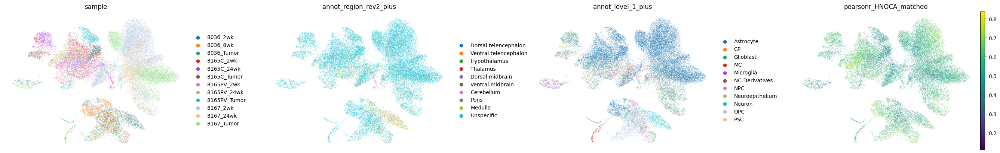

In [120]:
sc.pl.umap(adata_jacob_re,
           color=['sample','annot_region_rev2_plus','annot_level_1_plus','pearsonr_HNOCA_matched'],
           frameon=False, add_outline=False, wspace=0.3, size=1, ncols=4)

In [124]:
adata_jacob_re.obsm['umap_pre'] = adata[adata_jacob_re.obs_names,:].obsm['X_umap_scpoli_HNOCA'].copy()

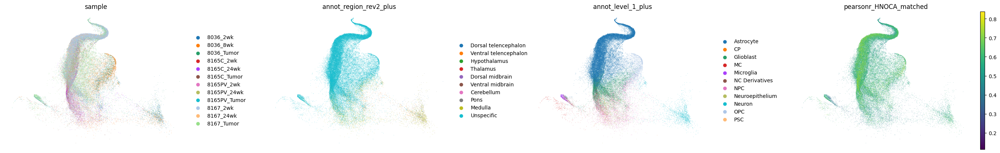

In [125]:
sc.pl.embedding(adata_jacob_re, basis='umap_pre',
                color=['sample','annot_region_rev2_plus','annot_level_1_plus','pearsonr_HNOCA_matched'],
                frameon=False, add_outline=False, wspace=0.3, size=1, ncols=4)

In [155]:
if 'X_umap_raw' not in adata_jacob_re.obsm.keys():
    adata_jacob_re.obsm['X_umap_raw'] = adata_jacob_re.obsm['X_umap'].copy()
sc.external.pp.bbknn(adata_jacob_re, batch_key='sample')
sc.tl.umap(adata_jacob_re)
adata_jacob_re.obsm['X_umap_bbknn'] = adata_jacob_re.obsm['X_umap'].copy()

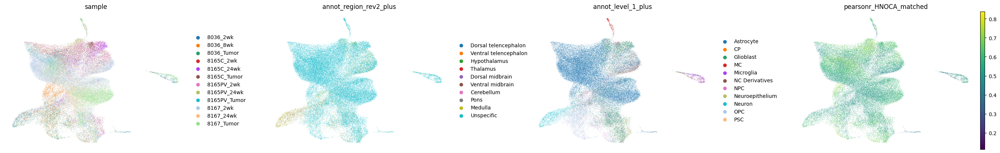

In [156]:
sc.pl.umap(adata_jacob_re,
           color=['sample','annot_region_rev2_plus','annot_level_1_plus','pearsonr_HNOCA_matched'],
           frameon=False, add_outline=False, wspace=0.3, size=1, ncols=4)

In [159]:
sc.external.pp.harmony_integrate(adata_jacob_re, key='sample')
sc.pp.neighbors(adata_jacob_re, use_rep='X_pca_harmony', key_added='harmony')
sc.tl.umap(adata_jacob_re, neighbors_key='harmony')
adata_jacob_re.obsm['X_umap_harmony'] = adata_jacob_re.obsm['X_umap'].copy()

2024-05-07 17:02:23,344 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-07 17:02:27,743 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-07 17:02:28,254 - harmonypy - INFO - Iteration 1 of 10
2024-05-07 17:02:53,917 - harmonypy - INFO - Iteration 2 of 10
2024-05-07 17:03:14,825 - harmonypy - INFO - Iteration 3 of 10
2024-05-07 17:03:34,210 - harmonypy - INFO - Iteration 4 of 10
2024-05-07 17:03:54,571 - harmonypy - INFO - Iteration 5 of 10
2024-05-07 17:04:14,129 - harmonypy - INFO - Converged after 5 iterations


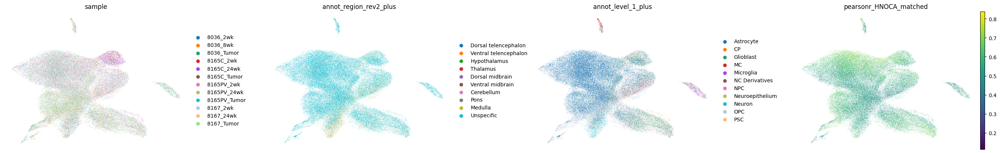

In [160]:
sc.pl.umap(adata_jacob_re,
           color=['sample','annot_region_rev2_plus','annot_level_1_plus','pearsonr_HNOCA_matched'],
           frameon=False, add_outline=False, wspace=0.3, size=1, ncols=4)

In [164]:
adata_jacob_re.write_h5ad('Jacob2019_reprocessed.h5ad')

In [109]:
sc.tl.louvain(adata_jacob_re, neighbors_key='harmony', key_added='louvain', resolution = 0.5)

In [110]:
sc.tl.louvain(adata_jacob_re, neighbors_key='harmony', key_added='louvain_1', resolution = 1)

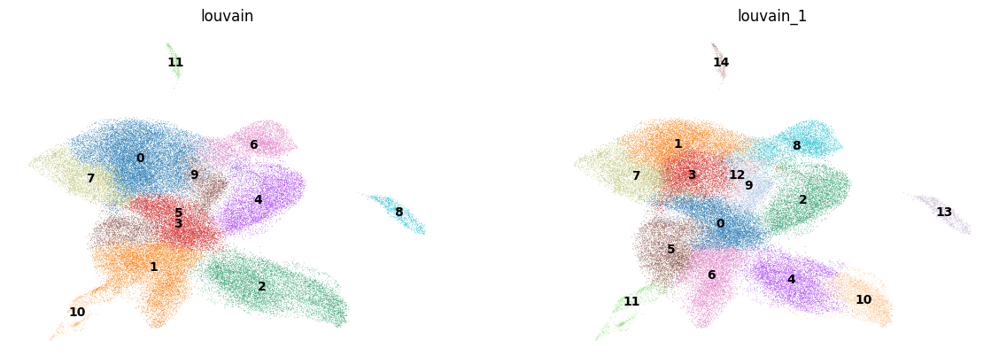

In [111]:
sc.pl.embedding(adata_jacob_re, basis='X_umap_harmony',
                color=['louvain', 'louvain_1'],
                frameon=False, add_outline=False, size=1, ncols=2, legend_loc='on data')

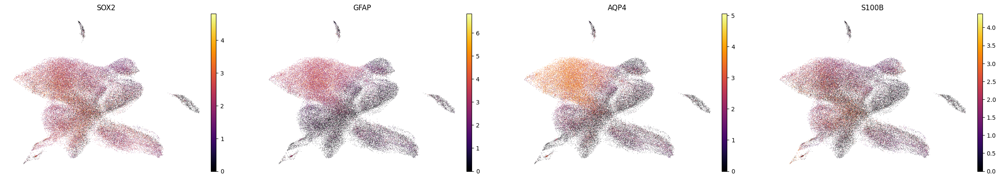

In [264]:
sc.pl.embedding(adata_jacob_re, basis='X_umap_harmony',
                color=['SOX2','GFAP','AQP4','S100B'], color_map='inferno',
                frameon=False, add_outline=False, size=1, ncols=4)

In [112]:
adata_jacob_re.write_h5ad('Jacob2019_reprocessed.h5ad')

### DE on the AQP4+ subset: louvain-res0.5 in [0, 7]

In [274]:
cellidx = adata_jacob_re[np.isin(adata_jacob_re.obs['louvain'], ['0','7']),:].obs_names
len(cellidx)

18159

In [275]:
shared_genes = np.intersect1d(adata_jacob.var_names, adata_jacob_bg.var_names)
len(shared_genes)

14142

In [276]:
expr0 = adata_jacob[cellidx,shared_genes].X - adata_jacob_bg[cellidx,shared_genes].X
expr0.shape

(18159, 14142)

In [277]:
df_DE = f_nonzero_test(np.array(expr0.todense()), var_names=shared_genes)
from statsmodels.stats.multitest import multipletests
df_DE['padj'] = multipletests(df_DE['pval'], method='holm')[1]
df_DE.head()

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 14142/14142 [02:33<00:00, 91.90it/s]


,f,coef,pval,padj
A1BG,5.535876,-0.437049,2.220446e-16,3.140155e-12
A1CF,1.001727,-0.000376,9.074732e-01,1.000000e+00
A2M,1.000228,-0.011529,9.877618e-01,1.000000e+00
A4GALT,1.001492,0.003141,9.199702e-01,1.000000e+00
AAAS,1.002817,0.028445,8.496768e-01,1.000000e+00


In [278]:
df_DE.to_csv('DE_Jacob2019_matchedHNOCA_AQP4pos.tsv', sep='\t')

In [279]:
df_DE = pd.read_csv('DE_Jacob2019_matchedHNOCA_AQP4pos.tsv', sep='\t', index_col=0, header=0)
df_DE_all = pd.read_csv('DE_Jacob2019_matchedHNOCA.tsv', sep='\t', index_col=0, header=0)

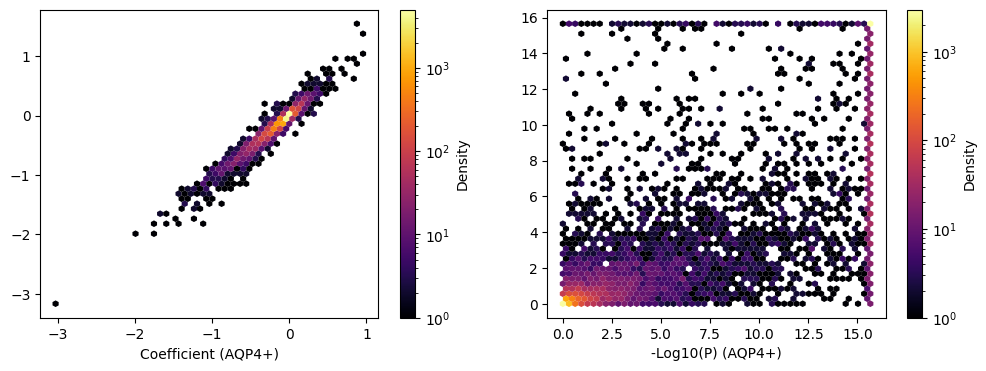

In [280]:
fig, ax = plt.subplots(1,2,figsize=(12,4))
m = ax[0].hexbin(df_DE_all['coef'],
                 df_DE['coef'],
                 gridsize=50, cmap='inferno', edgecolors='none', bins='log')
ax[0].set_xlabel('Coefficient (all)')
ax[0].set_xlabel('Coefficient (AQP4+)')
fig.colorbar(m, ax=ax[0],label='Density')
m = ax[1].hexbin(-np.log10(df_DE_all['pval']),
                 -np.log10(df_DE['pval']),
                 gridsize=50, cmap='inferno', edgecolors='none', bins='log')
ax[1].set_xlabel('-Log10(P) (all)')
ax[1].set_xlabel('-Log10(P) (AQP4+)')
fig.colorbar(m, ax=ax[1],label='Density')
plt.show()

In [282]:
pd.Series(np.sign(df_DE.loc[(df_DE['padj']<0.01) & (np.abs(df_DE['coef']) > np.log(1.2)),'coef'])).value_counts()

-1.0    1890
 1.0     155
Name: coef, dtype: int64

In [281]:
df_DE.loc[['SOX2','GFAP','AQP4','S100B'],:]

,f,coef,pval,padj
SOX2,1.003283,0.065868,8.252078e-01,1.000000e+00
GFAP,1.001617,-0.047215,9.132886e-01,1.000000e+00
AQP4,1.516933,0.692622,2.220446e-16,3.140155e-12
S100B,1.700190,-0.963408,2.220446e-16,3.140155e-12


In [285]:
df_DE.iloc[np.argsort(df_DE['coef'])[:10],:]

,f,coef,pval,padj
EEF1A1,11.446482,-3.168165,2.220446e-16,3.140155e-12
ACTB,4.121907,-2.024338,2.220446e-16,3.140155e-12
CKB,4.010094,-2.002916,2.220446e-16,3.140155e-12
METRN,6.753945,-1.855447,2.220446e-16,3.140155e-12
APOE,3.828239,-1.853511,2.220446e-16,3.140155e-12
FTH1,3.185304,-1.799727,2.220446e-16,3.140155e-12
ALDOA,11.206916,-1.796772,2.220446e-16,3.140155e-12
PCSK1N,6.330201,-1.745131,2.220446e-16,3.140155e-12
YWHAQ,6.637489,-1.718801,2.220446e-16,3.140155e-12
TPT1,3.635845,-1.686577,2.220446e-16,3.140155e-12


In [286]:
df_DE.iloc[np.argsort(-df_DE['coef'])[:10],:]

,f,coef,pval,padj
SPARCL1,2.089401,1.550215,2.220446e-16,3.140155e-12
S100A6,2.114635,1.420855,2.220446e-16,3.140155e-12
NUCKS1,2.000764,1.085801,2.220446e-16,3.140155e-12
PTN,1.538870,0.964527,2.220446e-16,3.140155e-12
CALD1,1.668471,0.923117,2.220446e-16,3.140155e-12
NCL,1.673878,0.912420,2.220446e-16,3.140155e-12
HNRNPU,1.612069,0.860673,2.220446e-16,3.140155e-12
NES,1.424279,0.815814,2.220446e-16,3.140155e-12
SPARC,1.477220,0.810460,2.220446e-16,3.140155e-12
RBM25,1.503795,0.800968,2.220446e-16,3.140155e-12


In [287]:
df_DE_all.iloc[np.argsort(-df_DE['coef'])[:10],:]

,f,coef,pval,padj
SPARCL1,1.329541,0.838441,2.220446e-16,3.140155e-12
S100A6,1.520296,0.955722,2.220446e-16,3.140155e-12
NUCKS1,1.656384,0.948708,2.220446e-16,3.140155e-12
PTN,1.347560,0.810294,2.220446e-16,3.140155e-12
CALD1,1.271493,0.614669,2.220446e-16,3.140155e-12
NCL,1.417981,0.767620,2.220446e-16,3.140155e-12
HNRNPU,1.549041,0.856466,2.220446e-16,3.140155e-12
NES,1.180350,0.540107,2.220446e-16,3.140155e-12
SPARC,1.129275,0.423979,2.220446e-16,3.140155e-12
RBM25,1.347621,0.691627,2.220446e-16,3.140155e-12


## Kang et al. 2021 (Fragile X)

In [8]:
adata_kang = adata[adata.obs['publication']=='Kang, 2021',:]
adata_kang = anndata.AnnData(X = adata.raw.X[adata.obs['publication']=='Kang, 2021',:].copy(),
                              obs = adata_kang.obs.copy(),
                              var = adata.raw.var.copy())
adata_kang_bg = adata_bg_expr[adata_bg_expr.obs['publication']=='Kang, 2021',:]
[adata_kang.shape, adata_kang_bg.shape]

[(36557, 14323), (36557, 36842)]

### Reanalyze Kang et al. 2021 data before DE to choose a neuronal population to focus on

In [9]:
adata_kang_re = adata_kang.copy()
sc.pp.highly_variable_genes(adata_kang_re)
adata_kang_re.raw = adata_kang_re
adata_kang_re = adata_kang_re[:,adata_kang_re.var['highly_variable']]
sc.pp.scale(adata_kang_re)
sc.pp.pca(adata_kang_re, n_comps=20)
sc.pp.neighbors(adata_kang_re)
sc.tl.umap(adata_kang_re)

In [13]:
adata_kang_re.obsm['X_umap_raw'] = adata_kang_re.obsm['X_umap'].copy()

In [27]:
adata_kang_re.obs['nFeatures'] = np.array((adata_kang_re.raw.X > 0).sum(axis=1)).flatten()

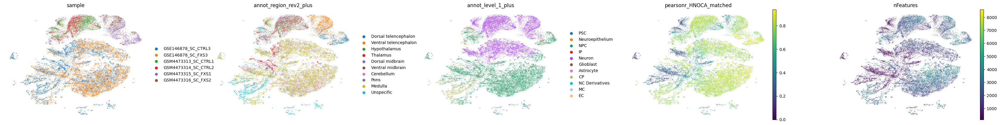

In [28]:
sc.pl.embedding(adata_kang_re, basis='X_umap_raw',
                color=['sample','annot_region_rev2_plus','annot_level_1_plus','pearsonr_HNOCA_matched', 'nFeatures'],
                frameon=False, add_outline=False, wspace=0.3, size=2, ncols=5)

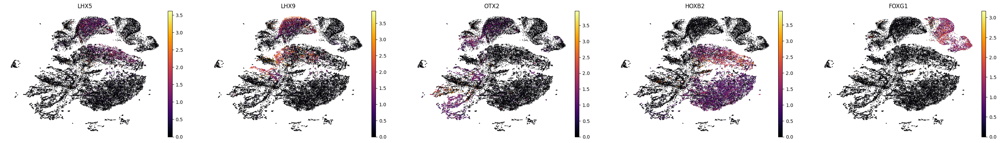

In [33]:
sc.pl.embedding(adata_kang_re, basis='X_umap_raw',
                color=['LHX5','LHX9','OTX2','HOXB2','FOXG1'],
                frameon=False, add_outline=False, color_map='inferno', size=5, ncols=5)

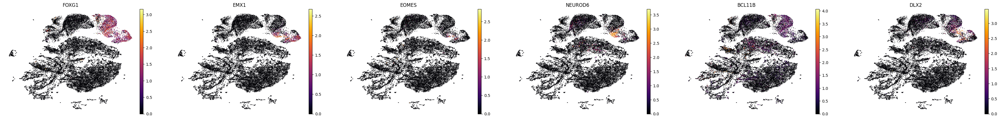

In [37]:
sc.pl.embedding(adata_kang_re, basis='X_umap_raw',
                color=['FOXG1','EMX1','EOMES','NEUROD6','BCL11B','DLX2'],
                frameon=False, add_outline=False, color_map='inferno', size=5, ncols=6)

In [12]:
pd.crosstab(adata_kang_re.obs['sample'], adata_kang_re.obs['annot_region_rev2_plus'])

annot_region_rev2_plus,Dorsal telencephalon,Ventral telencephalon,Hypothalamus,Thalamus,Dorsal midbrain,Ventral midbrain,Cerebellum,Pons,Medulla,Unspecific
sample,,,,,,,,,,
GSE146878_SC_CTRL3,83,0,20,1518,363,37,478,168,6236,2338
GSE146878_SC_FXS3,26,3,3,82,231,42,4036,1323,8340,680
GSM4473313_SC_CTRL1,59,142,664,792,460,91,4,38,209,217
GSM4473314_SC_CTRL2,77,64,656,1151,1002,119,10,58,278,173
GSM4473315_SC_FXS1,1191,946,57,124,1,5,0,1,36,186
GSM4473316_SC_FXS2,36,1587,20,7,0,0,0,2,17,70


In [34]:
sc.tl.louvain(adata_kang_re, key_added='louvain', resolution = 0.5)
sc.tl.louvain(adata_kang_re, key_added='louvain_1', resolution = 1)

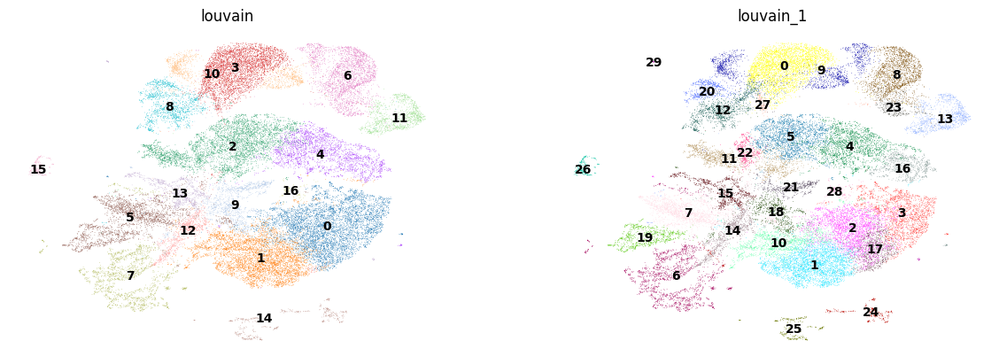

In [35]:
sc.pl.embedding(adata_kang_re, basis='X_umap_raw',
                color=['louvain', 'louvain_1'],
                frameon=False, add_outline=False, size=1, ncols=2, legend_loc='on data')

In [113]:
adata_kang_re.write_h5ad('Kang2021_reprocessed.h5ad')

### DE on the cortical cells: louvain-res1 in [13,23]

In [7]:
adata_kang_re = sc.read_h5ad('Kang2021_reprocessed.h5ad')

In [8]:
cellidx = adata_kang_re[np.isin(adata_kang_re.obs['louvain_1'], ['13','23']),:].obs_names
len(cellidx)

1449

In [10]:
adata_kang_re.obs.loc[cellidx,'condition'].value_counts()

FXS     1401
CTRL      48
Name: condition, dtype: int64

In [34]:
adata_kang_re.obs.loc[cellidx,['louvain_1','condition']].value_counts().loc[lambda x: x>0]

louvain_1  condition
13         FXS          1029
23         FXS           372
13         CTRL           47
23         CTRL            1
dtype: int64

In [40]:
shared_genes = np.intersect1d(adata_kang.var_names, adata_kang_bg.var_names)
len(shared_genes)

14142

In [41]:
expr0 = adata_kang[cellidx,shared_genes].X - adata_kang_bg[cellidx,shared_genes].X
expr0.shape

(1449, 14142)

In [44]:
df_DE = f_nonzero_test(np.array(expr0.todense()), var_names=shared_genes)
from statsmodels.stats.multitest import multipletests
df_DE['padj'] = multipletests(df_DE['pval'], method='holm')[1]
df_DE.head()

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████| 14142/14142 [01:16<00:00, 184.10it/s]


,f,coef,pval,padj
A1BG,1.008580,-0.039054,0.870872,1.0
A1CF,0.999323,0.000098,0.989715,1.0
A2M,1.029631,-0.004600,0.578513,1.0
A4GALT,1.011463,-0.001140,0.828329,1.0
AAAS,1.084280,-0.097858,0.123727,1.0


In [90]:
df_DE['padj2'] = multipletests(np.array([ 1 if np.isnan(x) else x for x in df_DE['pval']]), method='fdr_bh')[1]
df_DE.head()

,f,coef,pval,padj,padj2
A1BG,1.008580,-0.039054,0.870872,1.0,1.0
A1CF,0.999323,0.000098,0.989715,1.0,1.0
A2M,1.029631,-0.004600,0.578513,1.0,1.0
A4GALT,1.011463,-0.001140,0.828329,1.0,1.0
AAAS,1.084280,-0.097858,0.123727,1.0,1.0


In [91]:
df_DE.to_csv('DE_Kang2021_matchedHNOCA_corticalGlut.tsv', sep='\t')

In [46]:
pd.Series(np.sign(df_DE.loc[(df_DE['padj']<0.01) & (np.abs(df_DE['coef']) > np.log(1.2)),'coef'])).value_counts()

-1.0    201
 1.0     62
Name: coef, dtype: int64

In [92]:
pd.Series(np.sign(df_DE.loc[(df_DE['padj2']<0.01) & (np.abs(df_DE['coef']) > np.log(1.2)),'coef'])).value_counts()

-1.0    322
 1.0    122
Name: coef, dtype: int64

In [93]:
df_DE.iloc[np.argsort(df_DE['coef'])[:10],:]

,f,coef,pval,padj,padj2
TPI1,3.341570,-1.127665,2.220446e-16,3.140155e-12,2.934724e-14
MTRNR2L12,3.004601,-1.060661,2.220446e-16,3.140155e-12,2.934724e-14
ACTB,4.182441,-1.032029,2.220446e-16,3.140155e-12,2.934724e-14
ENO1,2.634952,-0.985542,2.220446e-16,3.140155e-12,2.934724e-14
GAPDH,3.088737,-0.970978,2.220446e-16,3.140155e-12,2.934724e-14
BNIP3,3.670654,-0.940706,2.220446e-16,3.140155e-12,2.934724e-14
MTRNR2L8,2.741439,-0.892457,2.220446e-16,3.140155e-12,2.934724e-14
UBB,2.100178,-0.877320,2.220446e-16,3.140155e-12,2.934724e-14
CHCHD2,3.455226,-0.849357,2.220446e-16,3.140155e-12,2.934724e-14
PGAM1,2.816940,-0.789644,2.220446e-16,3.140155e-12,2.934724e-14


In [94]:
df_DE.iloc[np.argsort(-df_DE['coef'])[:10],:]

,f,coef,pval,padj,padj2
MATR3,5.281507,1.216437,2.220446e-16,3.140155e-12,2.934724e-14
U2AF1,3.384691,0.925670,2.220446e-16,3.140155e-12,2.934724e-14
PTPRZ1,2.126837,0.743755,2.220446e-16,3.140155e-12,2.934724e-14
EIF4A1,2.143994,0.695984,2.220446e-16,3.140155e-12,2.934724e-14
ARGLU1,2.008172,0.692785,2.220446e-16,3.140155e-12,2.934724e-14
LUC7L3,2.045263,0.685745,2.220446e-16,3.140155e-12,2.934724e-14
PNISR,2.243701,0.669271,2.220446e-16,3.140155e-12,2.934724e-14
HES5,1.361300,0.640714,4.718743e-09,6.561883e-05,2.815715e-07
JUND,1.613858,0.564495,2.220446e-16,3.140155e-12,2.934724e-14
QKI,1.825193,0.538486,2.220446e-16,3.140155e-12,2.934724e-14


In [96]:
pd.Series(df_DE.index[(df_DE['padj2']<0.01) & (df_DE['coef'] > np.log(1.2))]).to_csv('output/DE_Kang2021_cEN_up.csv', index=False, header=False)

In [97]:
pd.Series(df_DE.index[(df_DE['padj2']<0.01) & (df_DE['coef'] < -np.log(1.2))]).to_csv('output/DE_Kang2021_cEN_down.csv', index=False, header=False)

In [73]:
adata_bg_expr.var.loc[np.isin(adata_bg_expr.var.index, shared_genes),'ensembl'].to_csv('output/DE_Kang2021_cEN_tested.csv', index=False, header=False)

In [77]:
sfari = pd.read_csv('../../ext/SFARI-Gene_genes_03-28-2024release_05-23-2024export.csv')
sfari.head()

,status,gene-symbol,gene-name,ensembl-id,chromosome,genetic-category,gene-score,syndromic,eagle,number-of-reports
0,9,ABAT,4-aminobutyrate aminotransferase,ENSG00000183044,16,"Rare Single Gene Mutation, Genetic Association",2.0,0,NaN,8
1,9,ABCA10,"ATP-binding cassette, sub-family A (ABC1), mem...",ENSG00000154263,17,Rare Single Gene Mutation,2.0,0,NaN,3
2,9,ABCA13,ATP binding cassette subfamily A member 13,ENSG00000179869,7,"Rare Single Gene Mutation, Functional",2.0,0,NaN,11
3,9,ABCA7,"ATP-binding cassette, sub-family A (ABC1), mem...",ENSG00000064687,19,Rare Single Gene Mutation,2.0,0,NaN,6
4,9,ABCE1,ATP binding cassette subfamily E member 1,ENSG00000164163,4,Rare Single Gene Mutation,1.0,0,NaN,3


In [105]:
sfari.shape

(1176, 10)

In [103]:
from scipy.stats import fisher_exact
mat = pd.crosstab(((df_DE['padj2']<0.01) & (df_DE['coef'] > np.log(1.2))),
                  np.isin(df_DE.index, sfari['gene-symbol']))
[ mat, fisher_exact(mat, alternative='greater') ]

[col_0  False  True 
 row_0              
 False  12982   1038
 True     104     18,
 SignificanceResult(statistic=2.164628723877279, pvalue=0.004071841527181606)]

In [104]:
from scipy.stats import fisher_exact
mat = pd.crosstab(((df_DE['padj2']<0.01) & (df_DE['coef'] < -np.log(1.2))),
                  np.isin(df_DE.index, sfari['gene-symbol']))
[ mat, fisher_exact(mat, alternative='greater') ]

[col_0  False  True 
 row_0              
 False  12777   1043
 True     309     13,
 SignificanceResult(statistic=0.5153822524644184, pvalue=0.99622509180373)]

### DE between MT and CL: only the Kang et al. data

In [50]:
from scipy.sparse import issparse
from scipy.stats import f
from statsmodels.formula.api import ols
from statsmodels.stats.anova import anova_lm
from joblib import Parallel, delayed
import multiprocessing
from tqdm import tqdm

def anova(e, group, covar=None, return_coef_group=None):
    if issparse(e):
        e = e.todense()
    e = np.array(e).flatten()
    
    if covar is None:
        m0 = ols('e ~ 1', data=pd.DataFrame({'e': e})).fit()
        m1 = ols('e ~ zz_group', data=pd.DataFrame({'e': e, 'zz_group': group})).fit()
    else:
        data = pd.DataFrame({'e': e, **covar, 'zz_group': group})
        m0 = ols('e ~ '+" + ".join(covar.columns), data=data).fit()
        m1 = ols('e ~ '+" + ".join(covar.columns)+' + zz_group', data=data).fit()
    
    a0 = anova_lm(m0)
    a1 = anova_lm(m1)
    a01 = anova_lm(m0, m1)
    p1 = a01.loc[:, 'Pr(>F)'].iloc[-1]
    p2 = 1-np.abs(0.5 - f.cdf(a0.loc['Residual','mean_sq']/a1.loc['Residual','mean_sq'], a0.loc['Residual','df'], a1.loc['Residual','df']))*2
    
    var_tot = a0['sum_sq'].sum()
    var_covar = a0.iloc[:-1]['sum_sq'].sum()
    var_g = a1.loc['zz_group', 'sum_sq']
    
    if return_coef_group is not None and return_coef_group in pd.Series(group).unique() and f'zz_group[T.{return_coef_group}]' in m1.params.index:
        coef_g = m1.params[f'zz_group[T.{return_coef_group}]']
    else:
        coef_g = np.nan
    
    return (var_g, var_covar, var_tot, p1, p2, coef_g)

def ancova_group_test(expr, group, covar=None, num_threads=1, return_coef_group=None, var_names=None):
    if not isinstance(group, pd.Series):
        group = pd.Series(group)
    idx = np.where(~group.isnull())[0]
    expr = expr[idx,:]
    group = group[idx]
    if covar is not None:
        covar = pd.DataFrame(covar).iloc[idx,:]
    
    if group.dtype.name != 'category':
        group = group.astype('category')
    group = group.cat.remove_unused_categories()
    g_lev = np.array(pd.Series(group).astype('category').cat.categories)
    if return_coef_group is not None and return_coef_group in g_lev:
        g_lev = np.concatenate([ g_lev[g_lev != return_coef_group], [return_coef_group] ])
        group = group.cat.reorder_categories(g_lev)
    
    num_cores = min(num_threads, multiprocessing.cpu_count())
    if num_cores > 1:
        results = Parallel(n_jobs=num_cores)(
            delayed(anova)(expr[:,i], group, covar, return_coef_group) for i in range(expr.shape[1])
        )
    else:
        results = list()
        for i in tqdm(range(expr.shape[1])):
            results.append(anova(expr[:,i], group, covar=covar, return_coef_group=return_coef_group))
    
    df_res = pd.DataFrame(results, columns=["var_group", "var_covar", "var_total", "p_ANCOVA", "p_Resi", "coef"])
    if var_names is not None and len(var_names) == df_res.shape[0]:
        df_res.index = var_names
    else:
        df_res.index = pd.RangeIndex(start=0, stop=expr.shape[1], step=1)
    return df_res

In [57]:
DE_kang = ancova_group_test(adata_kang_re.raw.X.todense(),
                            adata_kang_re.obs['disease'],
                            return_coef_group='fragile_x',
                            var_names=adata_kang_re.raw.var_names
                           )

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 14323/14323 [06:31<00:00, 36.58it/s]


In [73]:
from statsmodels.stats.multitest import multipletests
DE_kang['padj_Resi'] = multipletests(DE_kang['p_Resi'], method='holm')[1]

In [74]:
DE_kang.loc[['CHD2','FMR1'],:]

,var_group,var_covar,var_total,p_ANCOVA,p_Resi,coef,padj_Resi
CHD2,161.956491,0.0,18033.231608,1.073717e-73,3.898899e-01,-0.133240,1.000000e+00
FMR1,346.046247,0.0,3675.092393,0.000000e+00,2.220446e-16,-0.194761,3.180345e-12


In [71]:
idx = adata_kang_re.obs['annot_region_rev2_plus'] != 'Unspecific'
DE_kang_covar = ancova_group_test(adata_kang_re[idx,:].raw.X.todense(),
                                  adata_kang_re[idx,:].obs['disease'],
                                  covar=adata_kang_re[idx,:].obs[['annot_region_rev2_plus']],
                                  return_coef_group='fragile_x',
                                  var_names=adata_kang_re.raw.var_names
                                 )

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 14323/14323 [18:33<00:00, 12.86it/s]


In [75]:
from statsmodels.stats.multitest import multipletests
DE_kang_covar['padj_Resi'] = multipletests(DE_kang_covar['p_Resi'], method='holm')[1]

In [76]:
DE_kang_covar.loc[['CHD2','FMR1'],:]

,var_group,var_covar,var_total,p_ANCOVA,p_Resi,coef,padj_Resi
CHD2,63.790765,1876.453775,16157.641696,7.069055e-34,6.868421e-01,-0.109812,1.000000e+00
FMR1,224.546238,97.700570,3106.098327,0.000000e+00,2.069678e-12,-0.206028,2.963158e-08


In [88]:
idx = (~np.isin(adata_kang_re.obs['sample'], ['GSE146878_SC_FXS3','GSE146878_SC_CTRL3'])) & (adata_kang_re.obs['annot_region_rev2_plus'] != 'Unspecific')
DE_kang_covar_no3 = ancova_group_test(adata_kang_re[idx,:].raw.X.todense(),
                                      adata_kang_re[idx,:].obs['disease'],
                                      covar=adata_kang_re[idx,:].obs[['annot_region_rev2_plus']],
                                      return_coef_group='fragile_x',
                                      var_names=adata_kang_re.raw.var_names
                                     )

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 14323/14323 [05:58<00:00, 40.00it/s]


In [89]:
from statsmodels.stats.multitest import multipletests
DE_kang_covar_no3['padj_Resi'] = multipletests(DE_kang_covar_no3['p_Resi'], method='holm')[1]

In [90]:
DE_kang_covar_no3.loc[['CHD2','FMR1'],:]

,var_group,var_covar,var_total,p_ANCOVA,p_Resi,coef,padj_Resi
CHD2,13.375121,53.713619,6111.770483,2.921778e-06,0.916456,-0.153858,1.0
FMR1,12.670270,48.432424,889.792443,1.630277e-34,0.453478,-0.149750,1.0


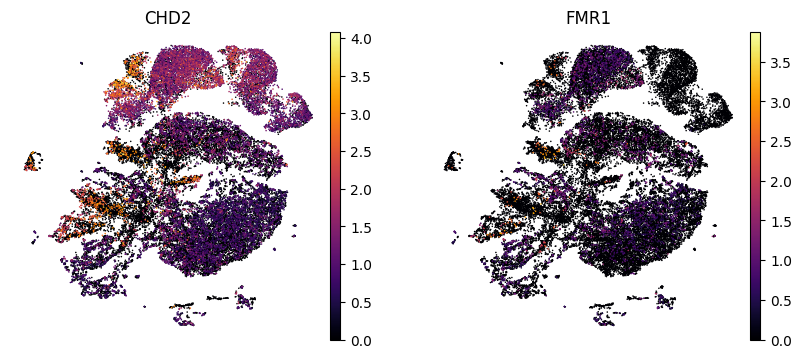

In [77]:
with plt.rc_context({'figure.figsize':(4,4)}):
    sc.pl.embedding(adata_kang_re, basis='X_umap_raw',
                    color=['CHD2','FMR1'],
                    frameon=False, add_outline=False, color_map='inferno', size=5, ncols=2)

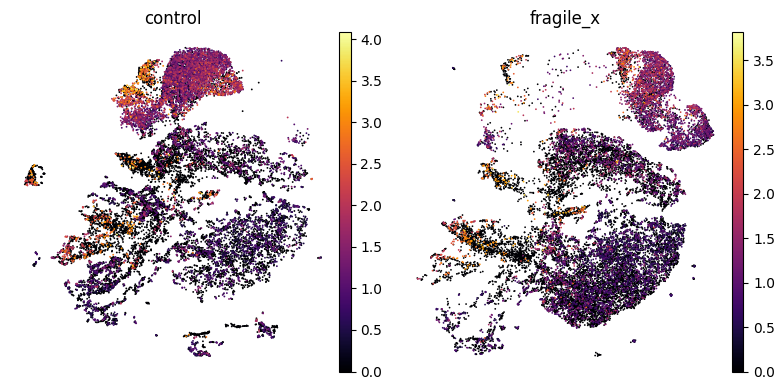

In [83]:
import scanpy as sc
import matplotlib.pyplot as plt
import numpy as np

def split_embedding(adata, split_by, basis='X_umap', ncol=2, nrow=None, **kwargs):
    categories = adata.obs[split_by].cat.categories
    if nrow is None:
        nrow = int(np.ceil(len(categories) / ncol))
    fig, axs = plt.subplots(nrow, ncol, figsize=(4*ncol, 4*nrow))
    axs = axs.flatten()
    for i, cat in enumerate(categories):
        ax = axs[i]
        sc.pl.embedding(adata[adata.obs[split_by] == cat], basis=basis, ax=ax, show=False, title=cat, **kwargs)
    plt.tight_layout()

split_embedding(adata_kang_re, color = ['CHD2'], split_by='disease', basis='X_umap_raw', legend_loc = "right margin", frameon=False, color_map='inferno')